# Final Report for Advanced Math for Deep Learning

#### Team Members

- **Andre Graham** - 101555540  
- **Majed Qarmout** - 101565483  
- **Younes Bensassi-Nour** - 101542854  
- **Yonatan Abebe** - 101532284  
- **Adnan Shaikh** - 101549676


## 1. Motivation and Dataset Details

### 1.1 Motivation Behind our Project

The world faces a growing waste crisis, with **2.01 billion tonnes of solid waste produced annually**, according to the [World Bank (2018)](https://datatopics.worldbank.org/what-a-waste/). Alarmingly, **8 million tonnes of plastic leak into our oceans every year**, severely affecting marine ecosystems and human health ([World Economic Forum, 2016](https://www.ellenmacarthurfoundation.org/publications/the-new-plastics-economy-rethinking-the-future-of-plastics)). This litter not only pollutes land and water but also endangers wildlife, disrupts ecosystems, and exacerbates the global environmental crisis.  

Traditional waste management practices face significant challenges in addressing this problem. **Inefficient monitoring systems** often fail to promptly detect dispersed litter, and **manual sorting processes** are time-consuming, labor-intensive, and prone to human error. These limitations hinder effective cleanup efforts and reduce recycling efficiency, allowing waste to continue accumulating in the environment.  

Real-time trash detection offers a transformative solution to these challenges. By leveraging automated detection systems, it becomes possible to identify waste types quickly and accurately across diverse environments. This technology empowers **enhanced cleanup efforts**, allowing for timely interventions to remove harmful litter. Additionally, it streamlines recycling processes, increasing efficiency and reducing contamination rates.  

As we confront the pressing environmental impacts of litter, **real-time trash detection systems** emerge as a crucial tool in fostering sustainable waste management practices. By addressing inefficiencies in monitoring, cleanup, and recycling, these solutions hold the potential to mitigate pollution, protect ecosystems, and contribute to a healthier planet.

### 1.2 Dataset Reference

Proença, Pedro F., and Simões, Pedro.  
**TACO: Trash Annotations in Context for Litter Detection**.  
*arXiv preprint arXiv:2003.06975*, 2020.  
[Link to paper](https://arxiv.org/abs/2003.06975) \
[Link to dataset](https://github.com/pedropro/TACO)


### 1.3 Data Analysis

This section contains the code to load the dataset, examples of images with bounding boxes within the dataset, detailed descriptions of the categories of the objects within the datset, distributions of number of objects in the dataset and the number of images in the dataset with at least one of an object, and pie charts the further illustrate these distrbutions. 

In [ ]:
!git clone https://github.com/pedropro/TACO.git

Cloning into 'TACO'...
remote: Enumerating objects: 740, done.
remote: Counting objects: 100% (435/435), done.
remote: Compressing objects: 100% (55/55), done.
remote: Total 740 (delta 416), reused 380 (delta 380), pack-reused 305 (from 1)
Receiving objects: 100% (740/740), 97.48 MiB | 28.27 MiB/s, done.
Resolving deltas: 100% (499/499), done.


In [ ]:
%cd TACO
! python download.py
%cd ..

In [ ]:
import os

# Check the number of batch folders downloaded
data_path = 'TACO/data/'
batches = [folder for folder in os.listdir(data_path) if folder.startswith('batch_')]
print(f"Total number of batches: {len(batches)}")

Total number of batches: 15


In [ ]:
import json
import os

# Path to the annotations file
annotations_path = 'TACO/data/annotations.json'

# Check if the annotations file exists
if os.path.exists(annotations_path):
    with open(annotations_path, 'r') as f:
        data = json.load(f)

    # Get the number of images, categories, and annotations
    num_images = len(data['images'])  # List of images
    num_categories = len(data['categories'])  # List of categories
    num_annotations = len(data['annotations'])  # List of annotations

    print(f"Number of images: {num_images}")
    print(f"Number of categories: {num_categories}")
    print(f"Number of annotations: {num_annotations}")
else:
    print(f"Annotations file not found at: {annotations_path}")


Number of images: 1500
Number of categories: 60
Number of annotations: 4784


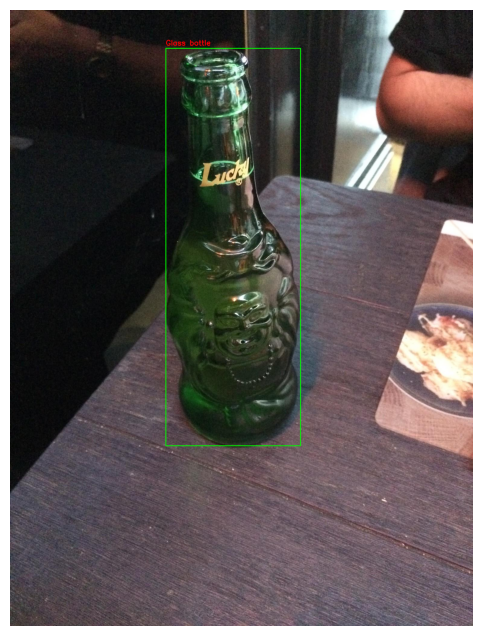

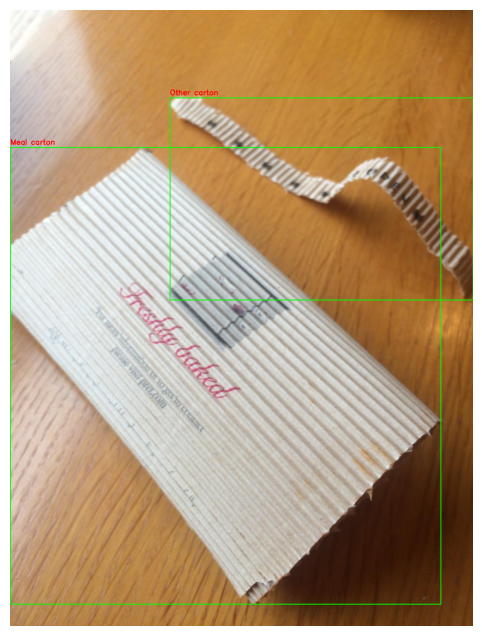

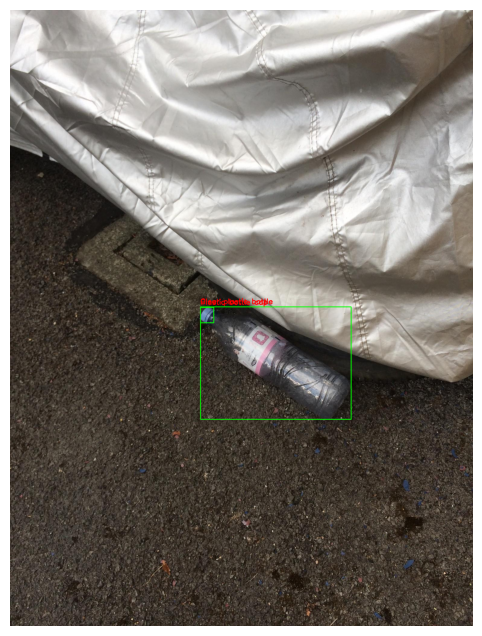

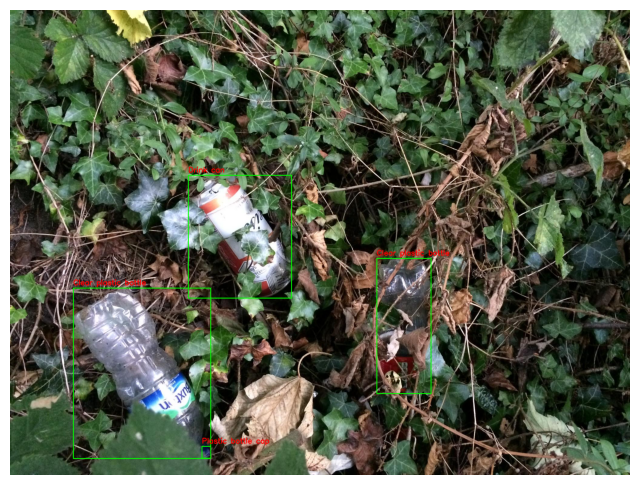

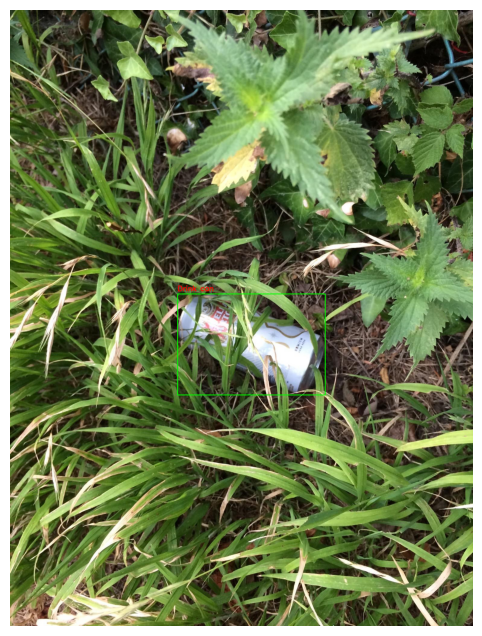

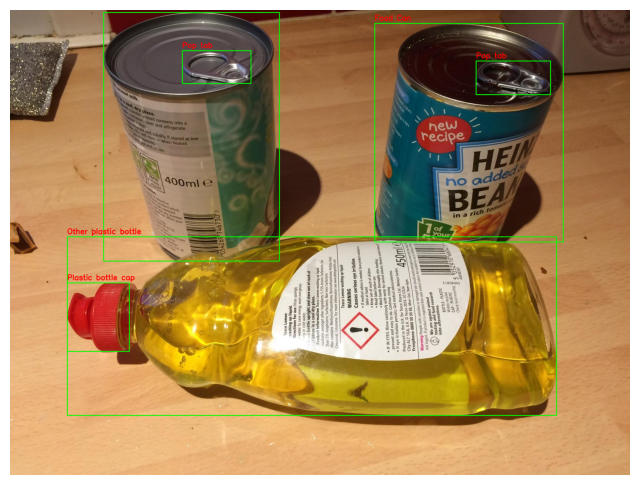

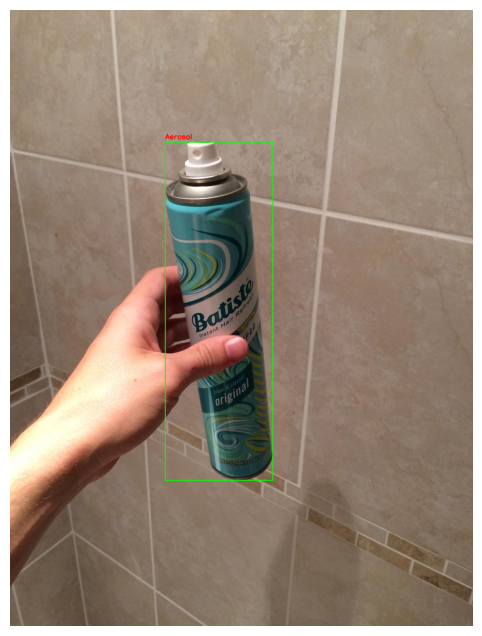

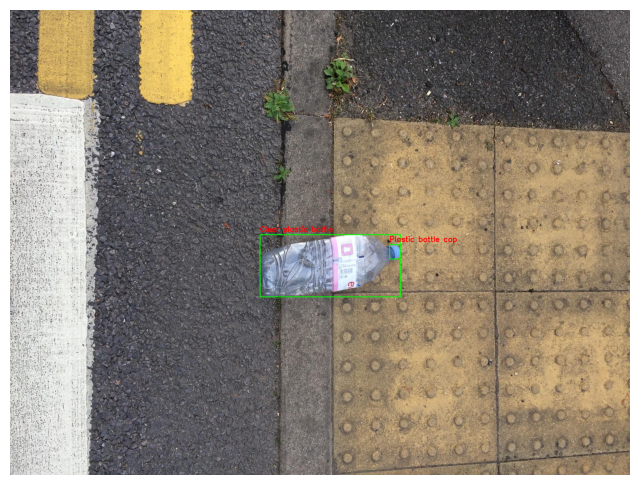

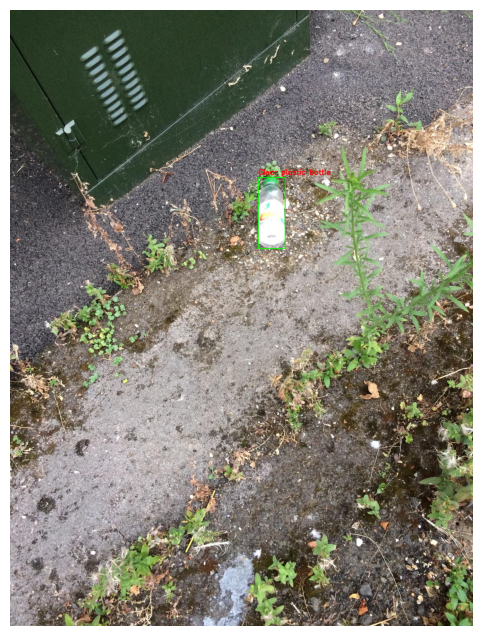

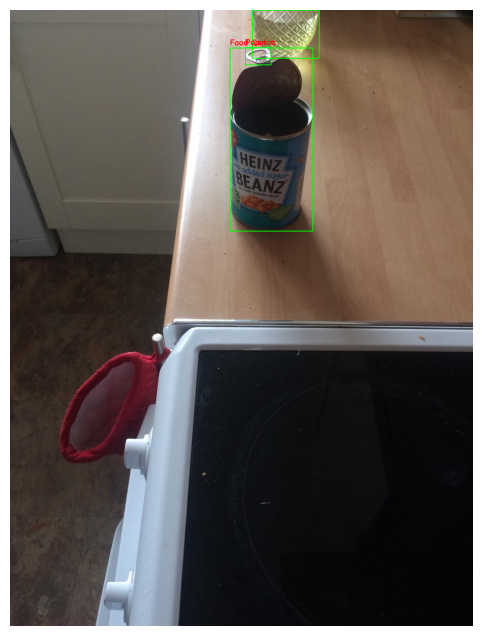

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Load the annotations file
with open(annotations_path) as f:
    annotations = json.load(f)
    
# Create dictionaries for images and annotations
images_dict = {img['id']: img for img in annotations['images']}
annotations_dict = {ann['image_id']: [] for ann in annotations['annotations']}
for ann in annotations['annotations']:
    annotations_dict[ann['image_id']].append(ann)

# Extract categories and annotations from the JSON data
categories = {cat['id']: cat['name'] for cat in data['categories']}
annotations = data['annotations']
images = {img['id']: img for img in data['images']}

def show_image_with_boxes(image_id):
    # Find the corresponding image info
    image_info = images.get(image_id)
    if not image_info:
        print(f"Image ID {image_id} not found in the dataset.")
        return

    # Construct the correct image path
    image_path = os.path.join(data_path, image_info['file_name'])

    # Check if the image exists
    if not os.path.exists(image_path):
        print(f"Could not find image at: {image_path}")
        return

    # Read the image using OpenCV
    image = cv2.imread(image_path)
    if image is None:
        print(f"Could not load image: {image_path}")
        return

    # Convert the image from BGR (OpenCV format) to RGB (for display in matplotlib)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Filter annotations for this image
    image_annotations = [ann for ann in annotations if ann['image_id'] == image_info['id']]

    # Draw bounding boxes and category labels on the image
    for ann in image_annotations:
        # Get bbox coordinates (x, y, width, height)
        x, y, width, height = map(int, ann['bbox'])  # Convert to integers
        category_id = ann['category_id']
        category_name = categories[category_id]

        # Draw the bounding box (green color, thickness=2)
        cv2.rectangle(image, (x, y), (x + width, y + height), (0, 255, 0), 2)

        # Add the category label in red above the bounding box
        label = f"{category_name}"
        cv2.putText(image, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)

    # Display the image with bounding boxes and category labels using matplotlib
    plt.figure(figsize=(8, 8))
    plt.imshow(image)
    plt.axis('off')  # Hide axes for better visualization
    plt.show()

# Show the first 10 images with bounding boxes and category labels
for i in range(10):
    show_image_with_boxes(i)

In [ ]:
# Extract categories from the annotations data
categories = data.get('categories', [])

# Create a dictionary to store supercategories and their corresponding categories
supercategory_dict = {}

# Iterate over categories to group them by supercategory
for category in categories:
    supercategory = category.get('supercategory', 'Uncategorized')  # Default to 'Uncategorized' if no supercategory
    category_name = category.get('name', 'Unknown Category')

    # Add the category under the corresponding supercategory
    if supercategory not in supercategory_dict:
        supercategory_dict[supercategory] = []
    supercategory_dict[supercategory].append(category_name)

# Now print each supercategory and its categories
for supercategory, category_list in supercategory_dict.items():
    print(f"Supercategory: {supercategory}")
    for category in category_list:
        print(f" - {category}")
    print()  # Add an empty line for readability


Supercategory: Aluminium foil
 - Aluminium foil

Supercategory: Battery
 - Battery

Supercategory: Blister pack
 - Aluminium blister pack
 - Carded blister pack

Supercategory: Bottle
 - Other plastic bottle
 - Clear plastic bottle
 - Glass bottle

Supercategory: Bottle cap
 - Plastic bottle cap
 - Metal bottle cap

Supercategory: Broken glass
 - Broken glass

Supercategory: Can
 - Food Can
 - Aerosol
 - Drink can

Supercategory: Carton
 - Toilet tube
 - Other carton
 - Egg carton
 - Drink carton
 - Corrugated carton
 - Meal carton
 - Pizza box

Supercategory: Cup
 - Paper cup
 - Disposable plastic cup
 - Foam cup
 - Glass cup
 - Other plastic cup

Supercategory: Food waste
 - Food waste

Supercategory: Glass jar
 - Glass jar

Supercategory: Lid
 - Plastic lid
 - Metal lid

Supercategory: Other plastic
 - Other plastic

Supercategory: Paper
 - Magazine paper
 - Tissues
 - Wrapping paper
 - Normal paper

Supercategory: Paper bag
 - Paper bag
 - Plastified paper bag

Supercategory: Plast

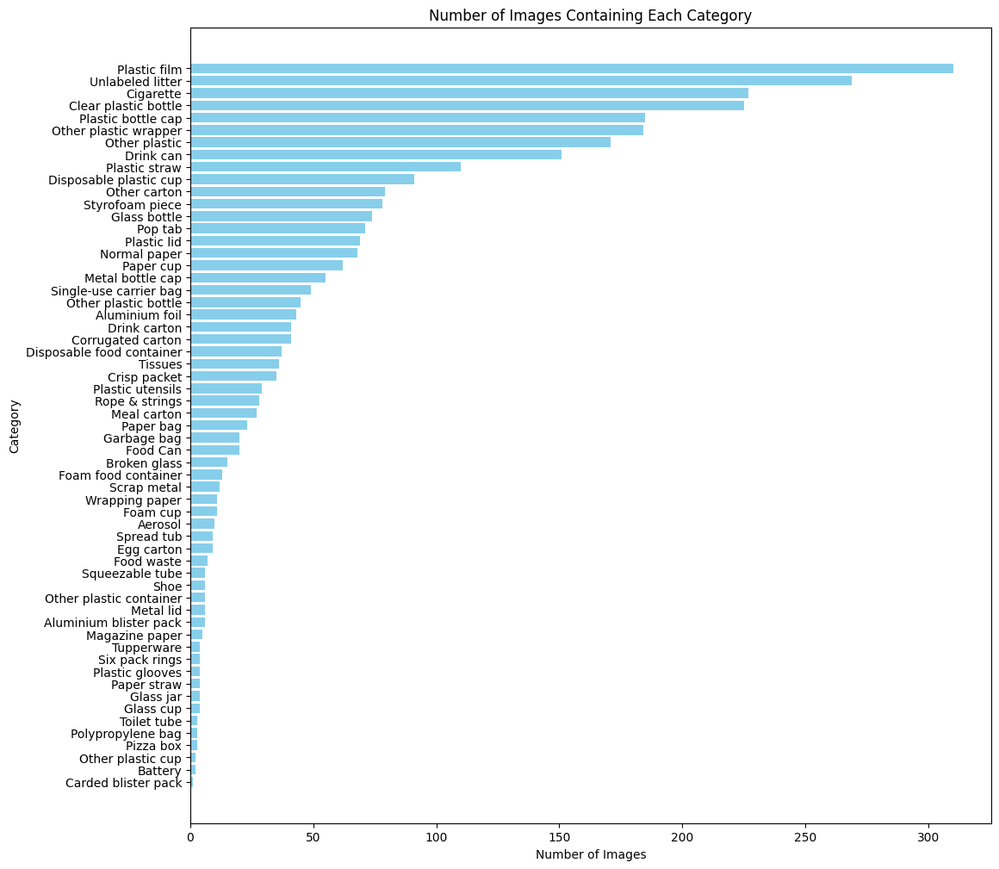

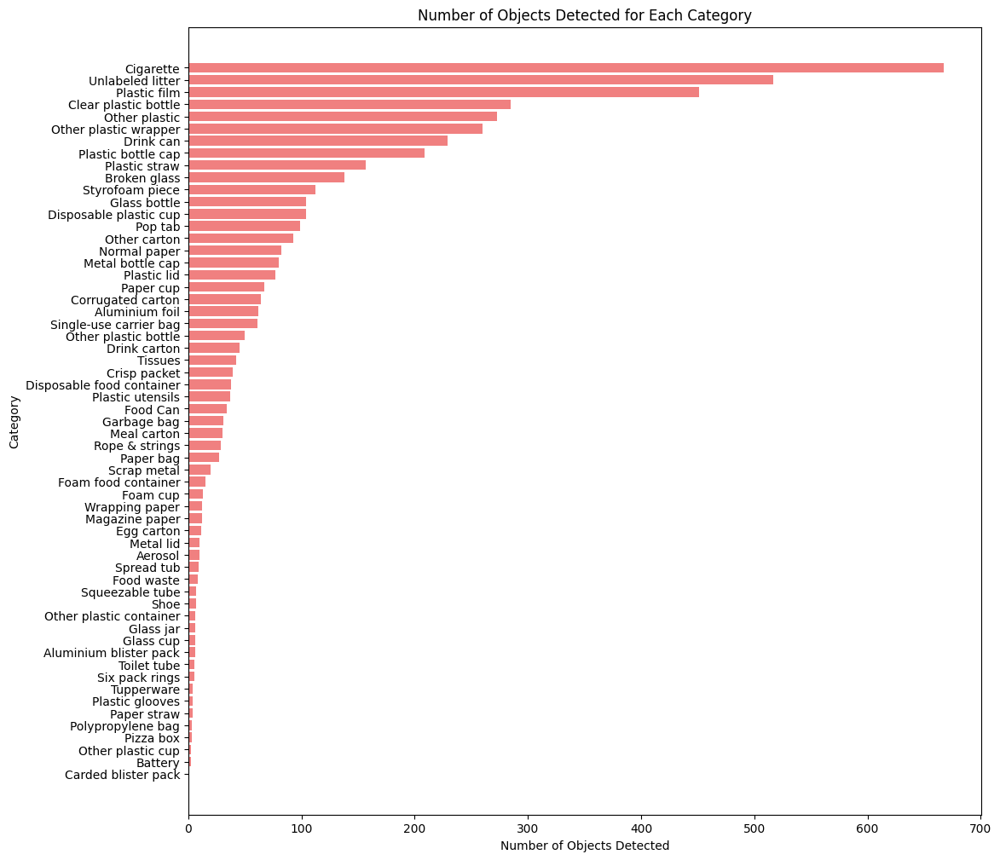

In [ ]:
from collections import defaultdict

# Extract the annotations and categories
annotations = data.get('annotations', [])
categories = data.get('categories', [])

# Create a mapping for category ids to names
category_id_to_name = {category['id']: category['name'] for category in categories}

# Create dictionaries to count images per category and objects per category
image_count_per_category = defaultdict(set)  # Uses a set to avoid counting the same image multiple times
object_count_per_category = defaultdict(int)

# Initialize total counts for calculating mean objects per image
total_objects = 0
unique_images = set()

# Iterate through annotations
for annotation in annotations:
    image_id = annotation['image_id']
    category_id = annotation['category_id']

    # Update the image count for the category (one image may contain multiple categories)
    image_count_per_category[category_id].add(image_id)

    # Update the object count for the category
    object_count_per_category[category_id] += 1

    # Update total objects and images
    total_objects += 1

    # Add image_id to the set of unique images
    unique_images.add(image_id)

# Convert image counts from sets to actual counts
image_count_per_category = {cat_id: len(images) for cat_id, images in image_count_per_category.items()}

# Convert category ids to category names for easier plotting
category_names = [category_id_to_name[cat_id] for cat_id in image_count_per_category.keys()]
image_counts = list(image_count_per_category.values())

# The total number of unique images
total_images = len(unique_images)

# Sort categories by number of images (descending order)
sorted_image_counts, sorted_category_names = zip(*sorted(zip(image_counts, category_names), reverse=False))

# Plot the histogram of number of images containing each category (sorted)
plt.figure(figsize=(12, 12))
plt.barh(sorted_category_names, sorted_image_counts, color='skyblue')
plt.xlabel('Number of Images')
plt.ylabel('Category')
plt.title('Number of Images Containing Each Category')
plt.show()

# Sort categories by number of objects (descending order)
object_counts = [object_count_per_category[cat_id] for cat_id in image_count_per_category.keys()]
sorted_object_counts, sorted_category_names_objects = zip(*sorted(zip(object_counts, category_names), reverse=False))

# Plot the histogram of number of objects detected for each category (sorted)
plt.figure(figsize=(12, 12))
plt.barh(sorted_category_names_objects, sorted_object_counts, color='lightcoral')
plt.xlabel('Number of Objects Detected')
plt.ylabel('Category')
plt.title('Number of Objects Detected for Each Category')
plt.show()


In [ ]:
# Calculate mean number of objects per image
mean_objects_per_image = round(total_objects / total_images, 2) if total_images != 0 else 0
print(f'Mean number of objects per image: {mean_objects_per_image}')

Mean number of objects per image: 3.19


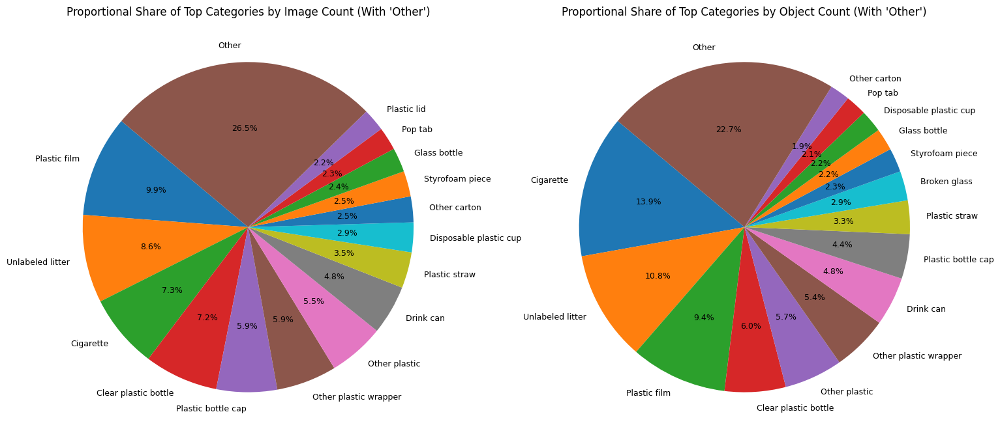

In [ ]:
# Assuming `object_count_per_category`, `image_count_per_category`, and `category_id_to_name` are defined as before

# Set the number of top categories to display
top_n = 15

# Sort and select the top categories for objects
sorted_object_counts = sorted(object_count_per_category.items(), key=lambda x: x[1], reverse=True)
top_object_categories = sorted_object_counts[:top_n]
other_object_categories = sorted_object_counts[top_n:]

# Sort and select the top categories for images
sorted_image_counts = sorted(image_count_per_category.items(), key=lambda x: x[1], reverse=True)
top_image_categories = sorted_image_counts[:top_n]
other_image_categories = sorted_image_counts[top_n:]

# Prepare data for top categories and 'Other' aggregation for images
top_image_category_names = [category_id_to_name[cat_id] for cat_id, _ in top_image_categories] + ["Other"]
top_image_category_counts = [count for _, count in top_image_categories]
top_image_category_counts.append(sum(count for _, count in other_image_categories))

# Prepare data for top categories and 'Other' aggregation for objects
top_object_category_names = [category_id_to_name[cat_id] for cat_id, _ in top_object_categories] + ["Other"]
top_object_category_counts = [count for _, count in top_object_categories]
top_object_category_counts.append(sum(count for _, count in other_object_categories))

# Calculate proportional shares
total_images = sum(top_image_category_counts)
proportional_shares_images = [(count / total_images) * 100 for count in top_image_category_counts]

total_objects = sum(top_object_category_counts)
proportional_shares_objects = [(count / total_objects) * 100 for count in top_object_category_counts]

# Plotting side-by-side pie charts with images on the left and objects on the right
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10))

# Pie chart for image counts
ax1.pie(proportional_shares_images, labels=top_image_category_names, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 9})
ax1.set_title("Proportional Share of Top Categories by Image Count (With 'Other')")

# Pie chart for object counts
ax2.pie(proportional_shares_objects, labels=top_object_category_names, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 9})
ax2.set_title("Proportional Share of Top Categories by Object Count (With 'Other')")

plt.show()


## 2. Preprocessing Steps

Here we will include sections such as converting to YOLO format, the data training pipelines for both YOLO and CNN, we can have both the from scratch code and the YOLO code in different sections

### 2.1 Data Preprocessing for Transfer Learning with YOLO

For the sake of this assignment, we discovered very quickly while using this dataset that in order to achieve reasonable results, we must reduce the total number of categories in our dataset. This is motivated by the fact that the vast majority of the categories in the dataset are underrepresented. We began filtering out data by choosing only the categories that had at least 200 instances of objects within the dataset. This resulted in us working with 7 categories: Plastic film, Unlabeled litter, Cigarette, Clear plastic bottle, Plastic bottle cap, Other plastic wrapper, Other plastic, and Drink can. We quickly found out that Other plastic wrapper, Other plastic, and Unlabeled litter would not work within our model. This will be shown through comparing the results of YOLO trial #1 and trial #2 in sections 3 and sections 4. 

Below you can see the data training pipline for our YOLO model.

In [ ]:
# put the training pipeline here

The remaining part of this section will show how we split the data into YOLO format, how we removed unwanted categories, and how we oversampled our data. Further data preprocessing such as normalization and data augmentation are completed during training the model. For brevitys sake, this section only includes how we preprocess the data for our final model. The only trials that have any different steps are trial #1, trial #3, and trial #4. To see the code that pre-processes that data for those trials, please visit our GitHub page for this project and see their respective python notebooks. This can be found in the YOLO directory.

The following code converts the data into YOLO format.

In [ ]:
import json
import os
from pathlib import Path
import shutil

# Paths to your TACO dataset
coco_json_path = 'TACO/data/annotations.json'  # Path to TACO's annotations file
images_dir = 'TACO/data'                       # Path to TACO's main image directory with batch subfolders
output_dir = 'yolo_top_categories'             # Base directory for YOLO format

# Ensure output directories for images and labels
Path(output_dir, 'images').mkdir(parents=True, exist_ok=True)
Path(output_dir, 'labels').mkdir(parents=True, exist_ok=True)

# Load TACO annotations
with open(coco_json_path, 'r') as f:
    data = json.load(f)

# Get category mappings
categories = {category['id']: category['name'] for category in data['categories']}

# Counter for unique filenames
file_counter = 1

# Process each image and corresponding annotations
for img in data['images']:
    img_id = img['id']
    img_file_name = img['file_name']  # This should be in the format 'batch_x/filename.jpg'
    img_width, img_height = img['width'], img['height']

    # Derive the image path within one of the 15 batch folders
    img_path = os.path.join(images_dir, img_file_name)

    # Create a unique integer-based name for each image and label
    unique_name = str(file_counter)
    img_extension = os.path.splitext(img_file_name)[1]  # Preserve the original extension (e.g., .jpg, .png)

    # Copy image to the images directory with the new unique name
    output_image_path = os.path.join(output_dir, 'images', unique_name + img_extension)
    if os.path.exists(img_path):
        shutil.copy(img_path, output_image_path)

        # Create a corresponding label file with the same unique integer name
        label_file_path = os.path.join(output_dir, 'labels', unique_name + '.txt')
        with open(label_file_path, 'w') as label_file:
            # Find all annotations for the current image
            for ann in data['annotations']:
                if ann['image_id'] == img_id:
                    category_id = ann['category_id']
                    # Ensure the category is in our mapping
                    if category_id in categories:
                        # YOLO format requires x_center, y_center, width, and height normalized
                        x, y, width, height = ann['bbox']
                        x_center = (x + width / 2) / img_width
                        y_center = (y + height / 2) / img_height
                        width /= img_width
                        height /= img_height

                        # Write the label file in YOLO format: <class_id> <x_center> <y_center> <width> <height>
                        label_file.write(f"{category_id} {x_center} {y_center} {width} {height}\n")

        # Increment the counter for the next file
        file_counter += 1

# Print the total number of images moved
print(f"Total number of images processed: {file_counter - 1}")

Total number of images processed: 1500


Next, we delete the unwanted categories from our labels. We also delete all images that do not contain any relavent objects along with their corresponding labels. For a more detailed description of exactly what the code is doing, please refer to the comments.

In [ ]:
import os

# Path to the base directory containing unified 'images' and 'labels' folders
base_dir = 'yolo_top_categories'  # Adjust if necessary
label_dir = os.path.join(base_dir, 'labels')
image_dir = os.path.join(base_dir, 'images')

# Initialize a counter for deleted files
total_deleted_files = 0

# Loop over each label file in the labels directory
for label_file in os.listdir(label_dir):
    label_file_path = os.path.join(label_dir, label_file)

    # Check if the label file is empty
    if os.path.getsize(label_file_path) == 0:
        # Construct possible image file paths
        base_image_name = os.path.splitext(label_file)[0]
        image_file_path_jpg = os.path.join(image_dir, base_image_name + '.jpg')
        image_file_path_jpg_upper = os.path.join(image_dir, base_image_name + '.JPG')

        # Delete the label file
        os.remove(label_file_path)
        total_deleted_files += 1

        # Delete the associated image file if it exists
        if os.path.exists(image_file_path_jpg):
            os.remove(image_file_path_jpg)
            total_deleted_files += 1
        elif os.path.exists(image_file_path_jpg_upper):
            os.remove(image_file_path_jpg_upper)
            total_deleted_files += 1

# Print the total number of files deleted
print(f"Total number of files deleted (label and image): {total_deleted_files}")

Total number of files deleted (label and image): 1374


Next, we split the dataset into training, valdiation, and testing directories, staying in line with YOLO formatting.

In [ ]:
import shutil
import random

random.seed(42)

# Set the split ratios
train_ratio = 0.7
val_ratio = 0.2
test_ratio = 0.1

# Ensure output directories for each split
for split in ['train', 'val', 'test']:
    os.makedirs(os.path.join(base_dir, split, 'images'), exist_ok=True)
    os.makedirs(os.path.join(base_dir, split, 'labels'), exist_ok=True)

# Get a list of all images and shuffle them
all_images = [f for f in os.listdir(image_dir) if os.path.isfile(os.path.join(image_dir, f))]
random.shuffle(all_images)

# Calculate split sizes
num_train = int(len(all_images) * train_ratio)
num_val = int(len(all_images) * val_ratio)

# Assign images to each split
train_images = all_images[:num_train]
val_images = all_images[num_train:num_train + num_val]
test_images = all_images[num_train + num_val:]

# Move files to their respective split directories
for split, images in zip(['train', 'val', 'test'], [train_images, val_images, test_images]):
    for image_file in images:
        # Move image file
        src_image_path = os.path.join(image_dir, image_file)
        dst_image_path = os.path.join(base_dir, split, 'images', image_file)
        shutil.move(src_image_path, dst_image_path)

        # Move corresponding label file
        label_file = os.path.splitext(image_file)[0] + '.txt'
        src_label_path = os.path.join(label_dir, label_file)
        dst_label_path = os.path.join(base_dir, split, 'labels', label_file)
        if os.path.exists(src_label_path):  # Ensure corresponding label file exists
            shutil.move(src_label_path, dst_label_path)

# Print the number of images in each split
print(f"Number of images in train: {len(train_images)}")
print(f"Number of images in val: {len(val_images)}")
print(f"Number of images in test: {len(test_images)}")

Number of images in train: 569
Number of images in val: 162
Number of images in test: 82


We then delete the directories we orginally created for the images and labels to ensure we do not have unnecessary directories in our project files.

In [ ]:
# Paths to the original images and labels directories
image_dir = os.path.join(base_dir, 'images')
label_dir = os.path.join(base_dir, 'labels')

# Delete the original images and labels directories
if os.path.exists(image_dir):
    shutil.rmtree(image_dir)

if os.path.exists(label_dir):
    shutil.rmtree(label_dir)

print("Original images and labels directories have been deleted.")

Original images and labels directories have been deleted.


Due to there note being an even distribution of objects in the dataset, we perform oversampling to balance our training dataset.

In [ ]:
import os
from collections import Counter

def count_class_instances(label_dir):
    class_counts = Counter()
    for label_file in os.listdir(label_dir):
        label_file_path = os.path.join(label_dir, label_file)
        with open(label_file_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                class_id = int(line.strip().split()[0])
                class_counts[class_id] += 1
    return class_counts

# Paths to training labels
train_label_dir = os.path.join(base_dir, 'train', 'labels')

# Get class counts
class_counts = count_class_instances(train_label_dir)

print("Class distribution in the training set:")
for class_id, count in class_counts.items():
    print(f"Class {class_id}: {count} instances")


Class distribution in the training set:
Class 2: 195 instances
Class 0: 324 instances
Class 1: 476 instances
Class 4: 173 instances
Class 3: 148 instances


In [ ]:
# Determine the threshold for underrepresentation (e.g., 50% of the max count)
max_count = max(class_counts.values())
threshold = 0.8 * max_count

# Identify underrepresented classes
underrepresented_classes = [class_id for class_id, count in class_counts.items() if count < threshold]

print("\nUnderrepresented classes:")
for class_id in underrepresented_classes:
    print(f"Class {class_id}: {class_counts[class_id]} instances")


Underrepresented classes:
Class 2: 195 instances
Class 0: 324 instances
Class 4: 173 instances
Class 3: 148 instances


In [ ]:
# Calculate the number of instances needed for each underrepresented class

target_count = int(0.90* max_count)  # 80% of the max count

instances_needed = {}
for class_id, count in class_counts.items():
    if count < target_count:
        instances_needed[class_id] = int(target_count - count)

print("\nInstances needed for balance:")
for class_id, count_needed in instances_needed.items():
    print(f"Class {class_id}: {count_needed} instances needed")


Instances needed for balance:
Class 2: 233 instances needed
Class 0: 104 instances needed
Class 4: 255 instances needed
Class 3: 280 instances needed


In [ ]:
# Initialize a mapping from class IDs to image filenames
images_to_duplicate = {class_id: [] for class_id in underrepresented_classes}

# Loop through label files to identify suitable images
for label_file in os.listdir(train_label_dir):
    label_file_path = os.path.join(train_label_dir, label_file)
    with open(label_file_path, 'r') as f:
        lines = f.readlines()
        image_classes = set()
        for line in lines:
            class_id = int(line.strip().split()[0])
            image_classes.add(class_id)
        # Check if the image contains only underrepresented classes
        if image_classes.issubset(underrepresented_classes):
            for class_id in image_classes:
                images_to_duplicate[class_id].append(label_file)

In [ ]:
import shutil
import numpy as np

# Directory paths
train_image_dir = os.path.join(base_dir, 'train', 'images')
train_label_dir = os.path.join(base_dir, 'train', 'labels')

# Counter for new filenames
duplication_counter = 0

# Oversample images for each underrepresented class
for class_id in underrepresented_classes:
    count_needed = instances_needed[class_id]
    available_labels = images_to_duplicate[class_id]
    if not available_labels:
        print(f"No images found containing only class {class_id}")
        continue

    total_images = len(available_labels)
    duplicates_per_image = int(np.ceil(count_needed / total_images))

    for label_filename in available_labels:
        if count_needed <= 0:
            break

        image_filename = os.path.splitext(label_filename)[0]
        image_extensions = ['.jpg', '.png', '.jpeg']  # Adjust based on your dataset

        # Find the correct image extension
        for ext in image_extensions:
            image_path = os.path.join(train_image_dir, image_filename + ext)
            if os.path.exists(image_path):
                break
        else:
            continue  # Skip if image file not found

        label_path = os.path.join(train_label_dir, label_filename)

        for _ in range(duplicates_per_image):
            if count_needed <= 0:
                break

            # Create new filenames for duplicated files
            new_image_filename = f"{image_filename}_dup_{duplication_counter}{ext}"
            new_label_filename = f"{image_filename}_dup_{duplication_counter}.txt"

            new_image_path = os.path.join(train_image_dir, new_image_filename)
            new_label_path = os.path.join(train_label_dir, new_label_filename)

            # Copy image and label files
            shutil.copy(image_path, new_image_path)
            shutil.copy(label_path, new_label_path)

            count_needed -= len(open(label_path).readlines())
            duplication_counter += 1

print(f"\nOversampling completed. Duplicated images {duplication_counter} times.")


Oversampling completed. Duplicated images 393 times.


Below, the results of our oversampling can be seen. Notice the difference in the distributions of the training set relative to the validation and test sets, indicating that oversampling was successful. 

In [ ]:
# Re-count class instances after oversampling
new_class_counts = count_class_instances(train_label_dir)

print("\nUpdated class distribution in the training set:")
for class_id in sorted(new_class_counts.keys()):
    print(f"Class {class_id}: {new_class_counts[class_id]} instances")


Updated class distribution in the training set:
Class 0: 483 instances
Class 1: 476 instances
Class 2: 442 instances
Class 3: 379 instances
Class 4: 413 instances


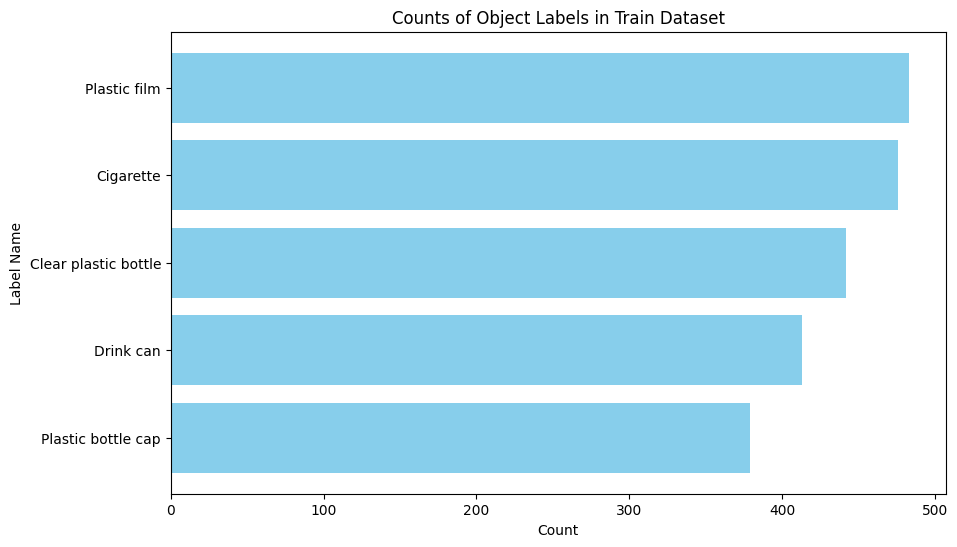

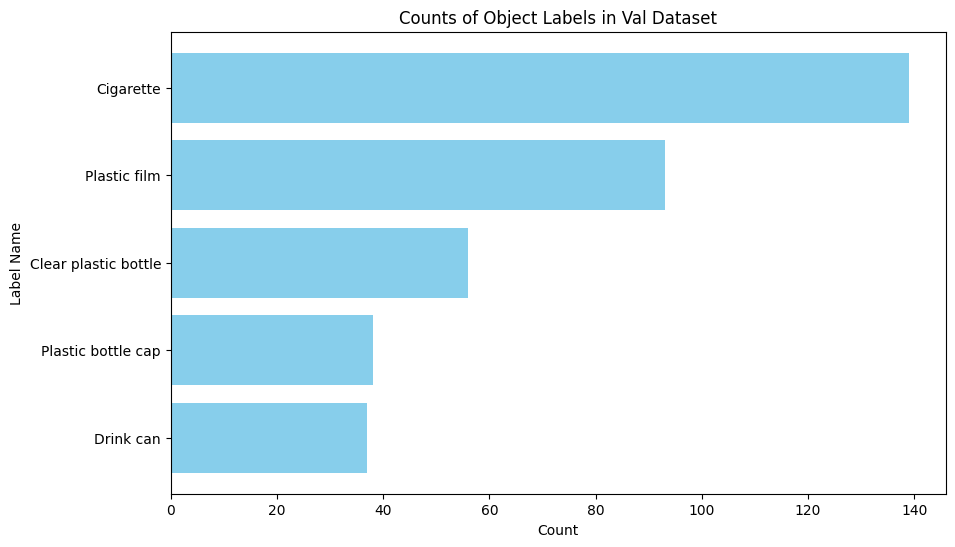

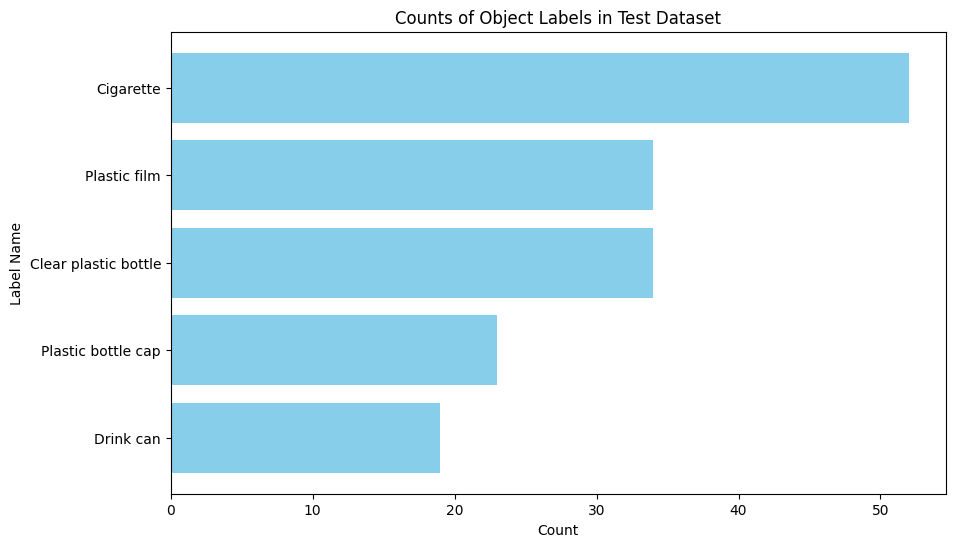

In [ ]:
import matplotlib.pyplot as plt

# Define a mapping from label IDs to names, excluding unwanted categories
label_names = {
    0: "Plastic film",
    1: "Cigarette",
    2: "Clear plastic bottle",
    3: "Plastic bottle cap",
    4: "Drink can"
}



# Function to plot label counts for a given split
def plot_label_counts(split, label_counts):
    # Convert label IDs to label names and sort by count
    labels, counts = zip(*sorted(
        [(label_names[label_id], count) for label_id, count in label_counts.items()],
        key=lambda x: x[1]
    ))

    # Plotting a horizontal bar chart for the split
    plt.figure(figsize=(10, 6))
    plt.barh(labels, counts, color='skyblue')
    plt.xlabel("Count")
    plt.ylabel("Label Name")
    plt.title(f"Counts of Object Labels in {split.capitalize()} Dataset")
    plt.show()

# Loop through each split and calculate label distributions
for split in ['train', 'val', 'test']:
    label_dir_split = os.path.join(base_dir, split, 'labels')

    # Initialize a counter for label counts for the current split
    label_counts = Counter()

    # Loop over each label file in the current label directory
    for label_file in os.listdir(label_dir_split):
        label_file_path = os.path.join(label_dir_split, label_file)

        # Read the label file
        with open(label_file_path, 'r') as file:
            lines = file.readlines()

            # Count each label in the file
            for line in lines:
                parts = line.strip().split()
                label_id = int(parts[0])  # The label ID is the first element
                label_counts[label_id] += 1

    # Plot label counts for the current split
    plot_label_counts(split, label_counts)


Finally, we create a YAML file which will be necessary for training our model. 

In [ ]:
import yaml

# Define the details for the YAML file, excluding unwanted categories
data_config = {
    'train': '/content/yolo_top_categories/train/images',
    'val': '/content/yolo_top_categories/val/images',
    'test': '/content/yolo_top_categories/test/images',
    'nc': 5,  # Updated number of classes
    'names': [
        "Plastic film",
        "Cigarette",
        "Clear plastic bottle",
        "Plastic bottle cap",
        "Drink can"
    ]
}

# Write to a YAML file
yaml_file_path = 'taco.yaml'  # Path where the YAML file will be saved
with open(yaml_file_path, 'w') as file:
    yaml.dump(data_config, file, default_flow_style=False)

print(f"YAML file created at: {yaml_file_path}")

YAML file created at: taco.yaml


### 2.2 Data Preprocessing for the Custom CNN Object Detection Model from Scratch

This section will include

- all data preprocessing code relavent to your model (make sure that it doesn't mess up the YOLO code, it just be completely seperate)
- the data training pipeline 

## 3. Base Model Training

### 3.1 Base Model Training for YOLO

The following is the summary of the base trial using YOLOv8l model

Trial Number: Trial 1
Date: 2024-11-12
Objective: Establish a baseline performance with a large YOLO model to detect small objects in complex environments.

---

Adjustments:
- Model Architecture: YOLOv8 large model (`yolov8l.pt`) selected to better handle small objects and complex backgrounds.
- Image Resolution: High resolution (1536x1536) was used to capture detail, crucial for detecting small objects within the dataset.
- Dataset Modification: Categories reduced to include only classes with a significant number of objects, increasing focus on relevant data and reducing noise.
- Hyperparameters:
  - Epochs: 100
  - Batch Size: 16
  - Patience: 15 (early stopping if no improvement)
  - Freeze Layers: First 10 layers frozen to leverage pretrained weights for low-level feature extraction
  - Augmentation: Enabled to help with model generalization on diverse backgrounds

---

Results:
Model Summary:
- Layers: 268
- Parameters: 43,612,776
- GFLOPs: 164.8

Performance Metrics:
- Overall:
  - Precision: 0.405
  - Recall: 0.363
  - mAP@50: 0.320
  - mAP@50-95: 0.235

Class-wise Metrics:
| Class                  | Instances | Precision | Recall | mAP@50 | mAP@50-95 |
|------------------------|-----------|-----------|--------|--------|------------|
| Plastic film           | 100       | 0.309     | 0.450  | 0.300  | 0.219      |
| Unlabeled litter       | 107       | 0.186     | 0.215  | 0.0841 | 0.0458     |
| Cigarette              | 112       | 0.626     | 0.411  | 0.443  | 0.252      |
| Clear plastic bottle   | 61        | 0.683     | 0.494  | 0.574  | 0.466      |
| Plastic bottle cap     | 39        | 0.385     | 0.513  | 0.458  | 0.352      |
| Other plastic wrapper  | 85        | 0.351     | 0.129  | 0.202  | 0.121      |
| Other plastic          | 59        | 0.392     | 0.153  | 0.150  | 0.132      |
| Drink can              | 35        | 0.306     | 0.543  | 0.345  | 0.289      |

Speed:
- Preprocessing: 0.7ms per image
- Inference: 100.4ms per image
- Postprocess: 0.9ms per image

---

Observations:
- The model architecture and high resolution have resulted in relatively strong performance on classes like Cigarette and Clear plastic bottle, likely due to the model’s ability to capture finer details at higher resolutions.
- Unlabeled litter, Other plastic wrapper, and Other plastic categories show low precision and recall, indicating difficulties in recognizing these classes in complex backgrounds.
- Average precision (mAP@50) across classes suggests that model adjustments are needed to improve detection, particularly in the challenging background settings.

Next Steps:
- Refine Classes: Consider removing low-performing categories (e.g., Unlabeled litter, Other plastic wrapper, Other plastic) to focus on classes with better detection potential.
- Augmentation Review: Investigate additional or targeted augmentation strategies that might better address the complex backgrounds in the dataset.
- Experiment with Hyperparameters: Consider reducing the batch size or adjusting learning rate to improve model convergence.

This baseline provides a foundation for further tuning and optimizations in subsequent trials.


### 3.2 Base Model Training for the Custom CNN Object Detection Model from Scratch

## 4. Hyperparameter Tuning

### 4.1 Hyperparameter Tuning for YOLO

#### The following is a list of parameters tuned throughout the testing period.

#### General Hyperparameters
1. **Epochs**: 
   - Trials 1–4: 100  
   - Trials 5–10: 200  

2. **Batch Size**: 16 (consistent across all trials)

3. **Patience (Early Stopping)**: 
   - Trials 1–4: 15  
   - Trials 5–10: 30  

4. **Freeze Layers**: 
   - Trials 1–6: First 10 layers frozen  
   - Trial 7: Increased to 15 layers  
   - Trial 9: Reduced to 5 layers  

5. **Learning Rate**:  
   - Trial 1-5: Default
   - Trial 6: `1e-4`  
   - Trials 8–10: `1e-5`  

6. **Optimizer**:  
   - Default (early trials): AUTO
   - Trials 6–10: Adam  

7. **Weight Decay**: 
   - Introduced in Trial 6: `5e-4`  

8. **Warmup**: 
   - Introduced in Trial 6: 3 warmup epochs with momentum of 0.8  

9. **Image Size**: 1536 (consistent across all trials)

10. **Dropout**: 
    - Trial 9: Introduced with a value of `0.1`  

11. **Scheduler**: 
    - Introduced in Trial 6: Cosine Learning Rate Scheduler  

#### Augmentation Hyperparameters
1. **Enabled**: Trials 1–10 for generalization purposes.

2. **MixUp Augmentation**: 
   - Trial 6 onwards: Probability `0.2`  

3. **HSV Augmentations** (introduced in Trial 6):  
   - Hue (`hsv_h`): `0.015`  
   - Saturation (`hsv_s`): `0.7`  
   - Value (`hsv_v`): `0.4`  

4. **Flipping**: 
   - `flipud`: `0.0`  
   - `fliplr`: `0.5`  

5. **Rotation**: 
   - Trials 6–8: `10.0` degrees  
   - Trials 9–10: Increased to `30.0` degrees  

6. **Shear**: 
   - Introduced in Trial 6: `2.0`  

7. **Translation**: 
   - Introduced in Trial 6: `0.1`  

8. **Scale**: 
   - Trial 9: Increased from `0.5` to `1.0`    

### 4.2 Hyperparameter Tuning for CNN model 

## 5. Model Evaluation 

### 5.1 Model Evaluation for YOLO

| **Trial** | **Precision** | **Recall** | **mAP@50** | **mAP@50-95** |
|-----------|---------------|------------|-------------|---------------|
| 1         | 0.405         | 0.363      | 0.320       | 0.235         |
| 2         | 0.502         | 0.546      | 0.494       | 0.359         |
| 3         | 0.309         | 0.322      | 0.275       | 0.124         |
| 4         | 0.406         | 0.373      | 0.351       | 0.271         |
| 5         | 0.637         | 0.452      | 0.492       | 0.380         |
| 6         | 0.529         | 0.563      | 0.520       | 0.361         |
| 7         | 0.559         | 0.424      | 0.443       | 0.290         |
| 8         | 0.579         | 0.480      | 0.497       | 0.330         |
| 9         | 0.579         | 0.584      | 0.589       | 0.436         |
| 10        | 0.677         | 0.529      | 0.633       | 0.488         |

### 5.2 Model Evaluation for Custom CNN Object Detection Model from Scratch

Keep track of training loss and accuracy. analyze your training and validation.

## 6. Examples of Inference using Our Models

### 6.1 Inference Using our Fine-Tuned YOLO Model


0: 1152x1536 1 Plastic film, 207.2ms
Speed: 11.2ms preprocess, 207.2ms inference, 1.8ms postprocess per image at shape (1, 3, 1152, 1536)


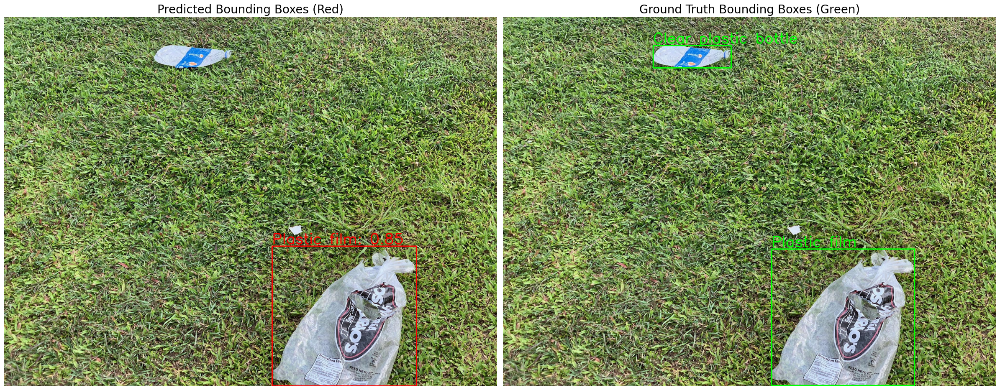


0: 1536x864 4 Cigarettes, 218.8ms
Speed: 10.3ms preprocess, 218.8ms inference, 2.1ms postprocess per image at shape (1, 3, 1536, 864)


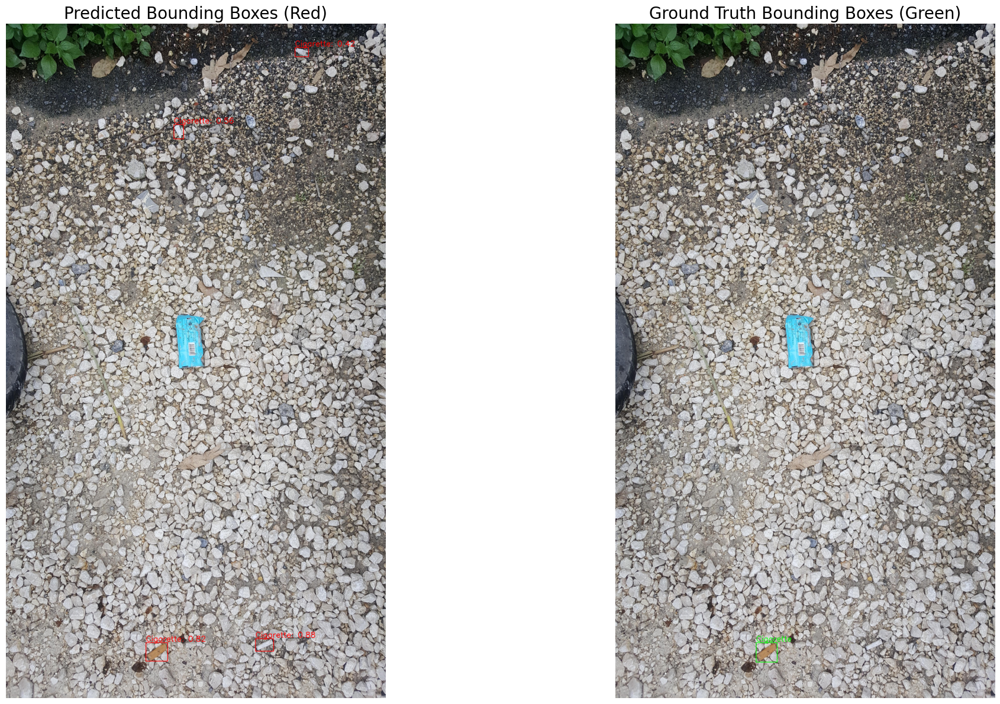


0: 1536x1152 1 Plastic film, 218.9ms
Speed: 13.4ms preprocess, 218.9ms inference, 2.0ms postprocess per image at shape (1, 3, 1536, 1152)


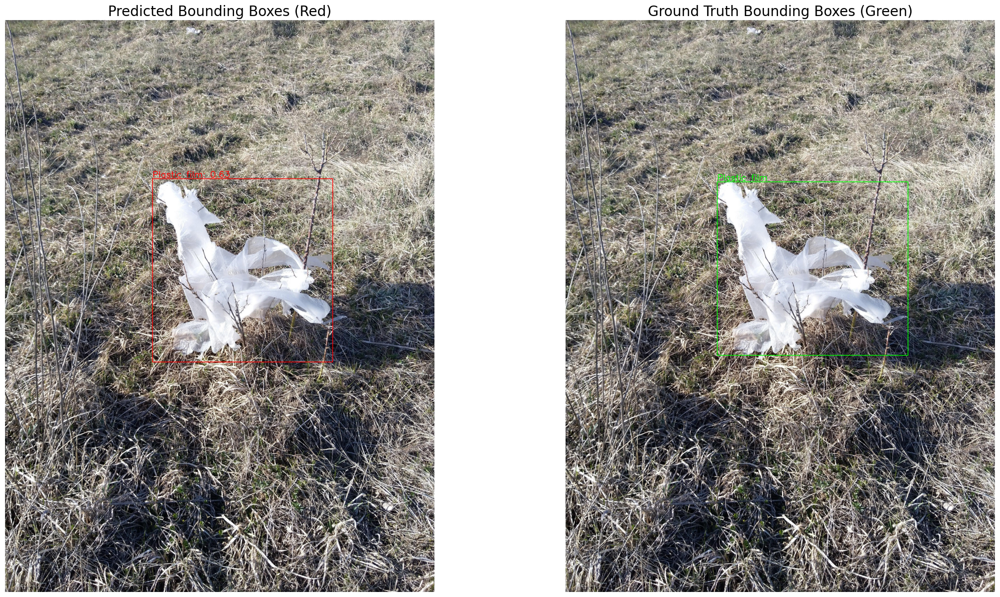


0: 1536x1152 1 Plastic bottle cap, 64.7ms
Speed: 11.5ms preprocess, 64.7ms inference, 1.7ms postprocess per image at shape (1, 3, 1536, 1152)


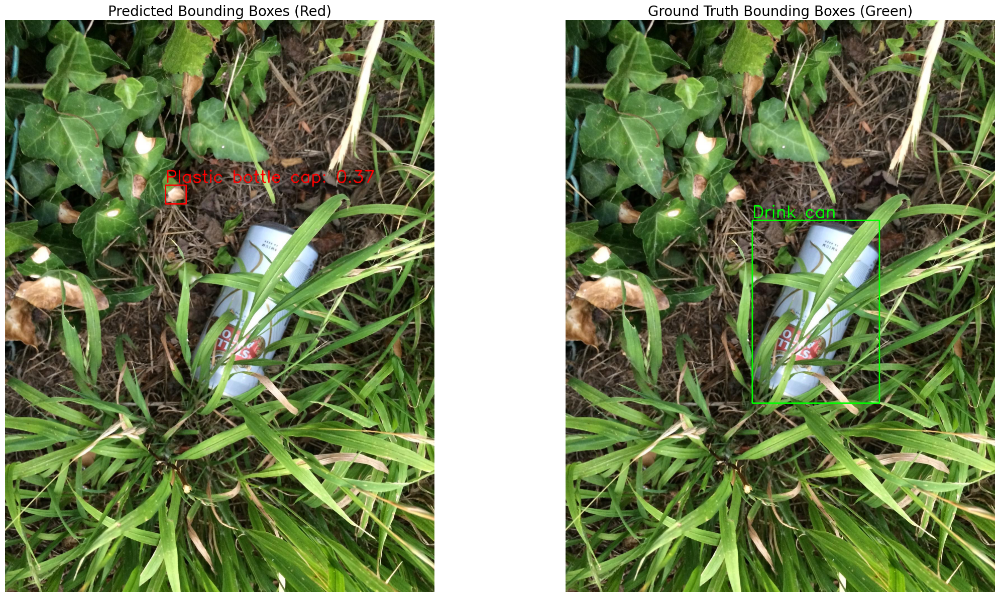

### 6.2 Inference Using our Fine-Tuned Custom CNN Object Detection Model

## 7. Results

## 8. Conclusion – Interpretation of Results

## 9. Report Summary

## 10. Next Steps

## 11. Lessons Learned

## 12. Presentation

## Appendix

### Section 1: requirements.txt

INCLUDE THE REQUIREMENTS.TXT CONTENTS FOR THIS PROJECT HERE!!!

### Section 2: Link to GitHub

INCLDUE THE LINK TO OUR PROJECT ON GITHUB HERE!!!